<a href="https://colab.research.google.com/github/UditSrinivasan/SFR-Cheques-Draft/blob/main/SFR_2910_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Tue Nov  5 06:14:26 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   60C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [4]:
!git clone https://github.com/WongKinYiu/yolov9.git
%cd yolov9
!pip install -r requirements.txt -q

Cloning into 'yolov9'...
remote: Enumerating objects: 781, done.
remote: Total 781 (delta 0), reused 0 (delta 0), pack-reused 781 (from 1)
Receiving objects: 100% (781/781), 3.27 MiB | 6.90 MiB/s, done.
Resolving deltas: 100% (331/331), done.
/content/yolov9
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 33.6 MB/s eta 0:00:00


In [5]:
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-e.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-e.pt

In [6]:
!ls -la {HOME}/weights

total 402440
drwxr-xr-x 2 root root      4096 Nov  5 06:15 .
drwxr-xr-x 1 root root      4096 Nov  5 06:15 ..
-rw-r--r-- 1 root root  51508261 Feb 18  2024 gelan-c.pt
-rw-r--r-- 1 root root 117203713 Feb 18  2024 gelan-e.pt
-rw-r--r-- 1 root root 103153312 Feb 18  2024 yolov9-c.pt
-rw-r--r-- 1 root root 140217688 Feb 18  2024 yolov9-e.pt


In [7]:
%cd {HOME}/yolov9

/content/yolov9


In [8]:
!pip install scikit-learn

In [9]:
%cd {HOME}/yolov9


/content/yolov9


In [11]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [12]:
import os
import random
import shutil
import torch

In [13]:
HOME = "/content/yolov9"
dataset_base_path = os.path.join(HOME, "data")
drive_path = "/content/drive/MyDrive/Model_2910"
images_path = os.path.join(drive_path, "images")
labels_path = os.path.join(drive_path, "labels")

In [14]:
output_dirs = {
    "train": {"images": os.path.join(dataset_base_path, "train/images"), "labels": os.path.join(dataset_base_path, "train/labels")},
    "val": {"images": os.path.join(dataset_base_path, "val/images"), "labels": os.path.join(dataset_base_path, "val/labels")},
    "test": {"images": os.path.join(dataset_base_path, "test/images"), "labels": os.path.join(dataset_base_path, "test/labels")},
}


In [15]:
for split in output_dirs.values():
    os.makedirs(split["images"], exist_ok=True)
    os.makedirs(split["labels"], exist_ok=True)

In [16]:
train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15

In [17]:
image_files = [f for f in os.listdir(images_path) if f.endswith(".jpg")]
random.shuffle(image_files)
train_end = int(train_ratio * len(image_files))
val_end = train_end + int(val_ratio * len(image_files))

In [18]:
splits = {
    "train": image_files[:train_end],
    "val": image_files[train_end:val_end],
    "test": image_files[val_end:]
}


In [19]:
for split_name, files in splits.items():
    for image_file in files:
        src_image_path = os.path.join(images_path, image_file)
        src_label_path = os.path.join(labels_path, image_file.replace(".jpg", ".txt"))

        dest_image_path = os.path.join(output_dirs[split_name]["images"], image_file)
        dest_label_path = os.path.join(output_dirs[split_name]["labels"], image_file.replace(".jpg", ".txt"))

        shutil.copy2(src_image_path, dest_image_path)
        shutil.copy2(src_label_path, dest_label_path)


In [20]:
weights_path = "/content/weights/gelan-c.pt"
cfg_path = "/content/yolov9/models/detect/gelan-c.yaml"
data_path = os.path.join(dataset_base_path, "data.yaml")

In [21]:
print("Train set size:", len(splits["train"]))
print("Validation set size:", len(splits["val"]))
print("Test set size:", len(splits["test"]))

Train set size: 130
Validation set size: 28
Test set size: 29


In [22]:
print("Number of GPU:", torch.cuda.device_count())
print("GPU Name:", torch.cuda.get_device_name())

Number of GPU: 1
GPU Name: Tesla T4


In [23]:
!python train.py \
--batch 16 --epochs 100 --img 640 --device 0 --min-items 0 --close-mosaic 15 \
--data {data_path} \
--weights {weights_path} \
--cfg {cfg_path} \
--hyp hyp.scratch-high.yaml

2024-11-05 06:24:15.878526: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-05 06:24:15.897746: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-05 06:24:15.903735: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-05 06:24:15.918027: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-11-05 06:24:17.142228: W tensorflow/comp

In [24]:
!ls {HOME}/runs/train/exp/

confusion_matrix.png				    opt.yaml	  train_batch0.jpg
events.out.tfevents.1730787889.d488c7675c72.3896.0  P_curve.png   train_batch1.jpg
F1_curve.png					    PR_curve.png  train_batch2.jpg
hyp.yaml					    R_curve.png   val_batch0_labels.jpg
labels_correlogram.jpg				    results.csv   val_batch0_pred.jpg
labels.jpg					    results.png   weights


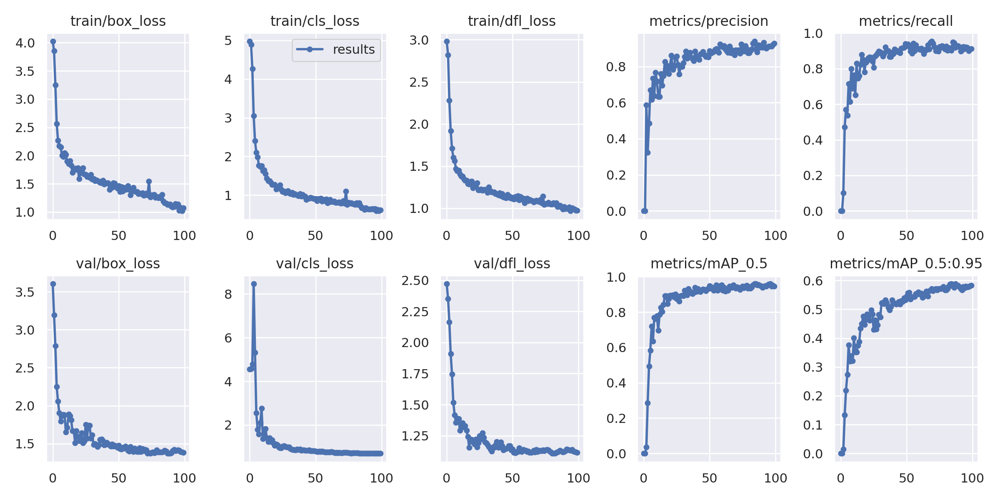

In [26]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/train/exp/results.png", width=1000)

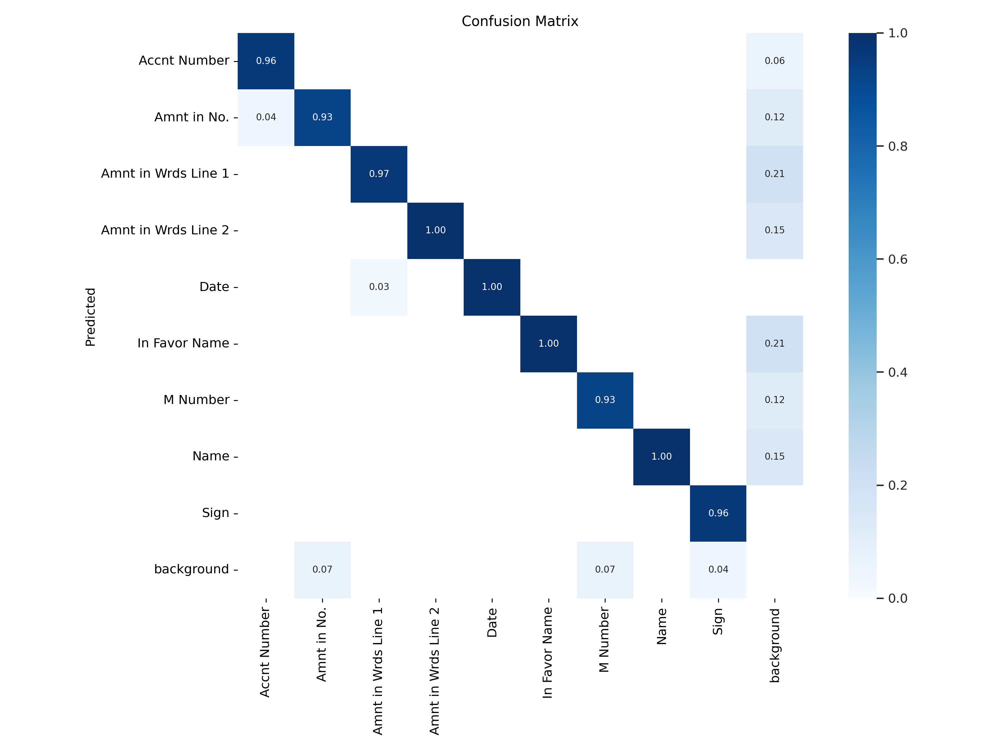

In [27]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/train/exp/confusion_matrix.png", width=1000)

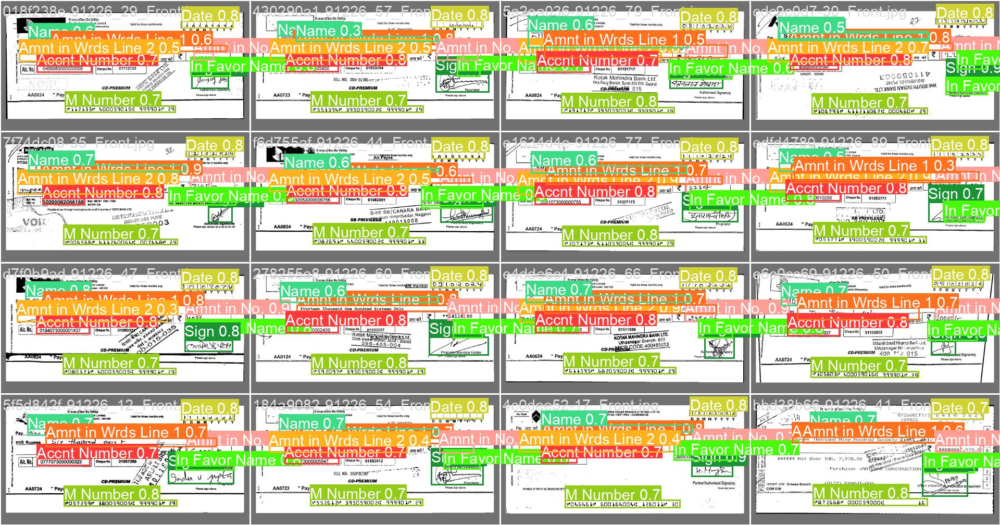

In [28]:
from IPython.display import Image

Image(filename=f"{HOME}/runs/train/exp/val_batch0_pred.jpg", width=1000)

In [30]:
%cd {HOME}
!python val.py \
--img 640 --batch 32 --conf 0.001 --iou 0.7 --device 0 \
--data /content/yolov9/data/data.yaml \
--weights {HOME}/runs/train/exp/weights/best.pt

/content/yolov9
val: data=/content/yolov9/data/data.yaml, weights=['/content/yolov9/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.7, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False, min_items=0
YOLO 🚀 v0.1-104-g5b1ea9a Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

/content/yolov9/models/experimental.py:243: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the funct

In [31]:
!python detect.py \
--img 1280 --conf 0.1 --device 0 \
--weights {HOME}/runs/train/exp/weights/best.pt \
--source /content/yolov9/data/test/images

detect: weights=['/content/yolov9/runs/train/exp/weights/best.pt'], source=/content/yolov9/data/test/images, data=data/coco128.yaml, imgsz=[1280, 1280], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLO 🚀 v0.1-104-g5b1ea9a Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

/content/yolov9/models/experimental.py:243: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future relea

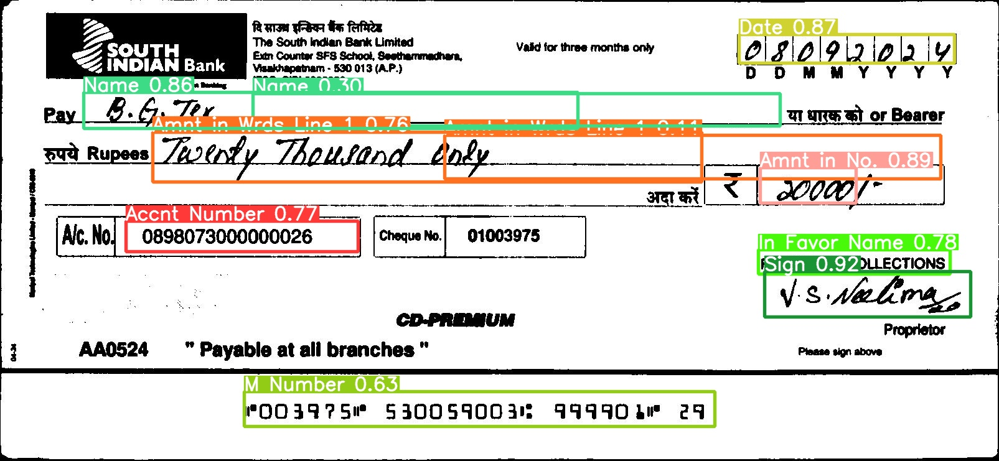

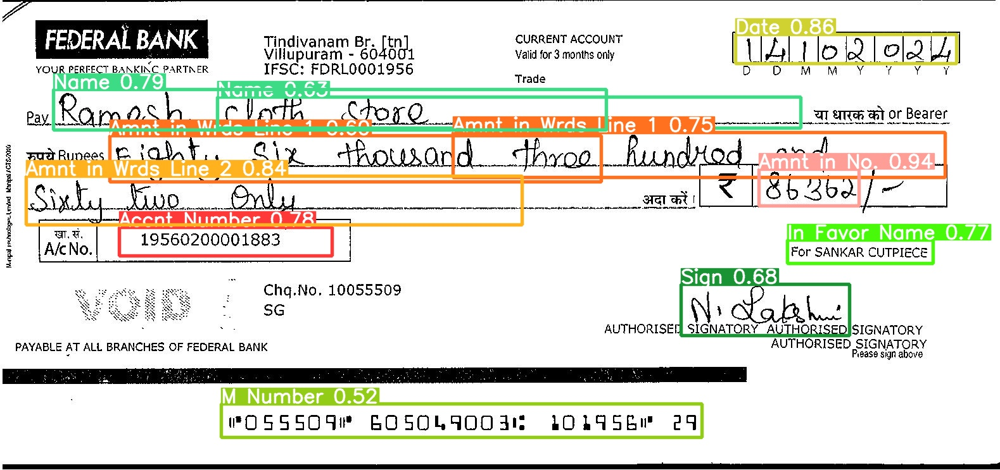

In [32]:
import glob

from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/exp/*.jpg')[:2]:
      display(Image(filename=image_path, width=600))

In [33]:
import json
import os
from pathlib import Path
import torch
import cv2


In [34]:
model = torch.hub.load('/content/yolov9', 'custom', path='/content/yolov9/runs/train/exp/weights/best.pt', source='local')

YOLO 🚀 v0.1-104-g5b1ea9a Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

/content/yolov9/models/experimental.py:243: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

In [35]:
source_dir = Path("/content/yolov9/data/test/images")
output_dir = Path("/content/yolov9/runs/detect/exp")
output_json = output_dir / 'detections.json'

In [36]:
detections = []

In [37]:
for img_path in source_dir.glob("*.jpg"):
    img = cv2.imread(str(img_path))
    results = model(img)

    # Collect bounding box information
    for result in results.xyxy[0]:  # results.xyxy[0] gives (x1, y1, x2, y2, conf, class)
        box = {
            "image": str(img_path.name),
            "x1": result[0].item(),
            "y1": result[1].item(),
            "x2": result[2].item(),
            "y2": result[3].item(),
            "confidence": result[4].item(),
            "class": int(result[5].item())
        }
        detections.append(box)

/content/yolov9/models/common.py:1063: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


In [38]:
with open(output_json, 'w') as f:
    json.dump(detections, f, indent=4)

print(f'Detections saved to {output_json}')

Detections saved to /content/yolov9/runs/detect/exp/detections.json


In [39]:
import json
import cv2
import numpy as np
import os
from pathlib import Path
from PIL import Image
from google.colab.patches import cv2_imshow

This is the Image with just the content in the bounding box


In [45]:
with open('/content/yolov9/runs/detect/exp/detections.json', 'r') as f:
    detections = json.load(f)

# Define the directory where your images are stored
image_dir = '/content/yolov9/data/test/images'  # Adjust this if necessary
output_dir = '/content/yolov9/data/output_images2'  # Directory to save the output images
os.makedirs(output_dir, exist_ok=True)

In [46]:
# Aggregate detections by image
image_detections = {}
for detection in detections:
    image_name = detection['image']
    x1, y1, x2, y2 = int(detection['x1']), int(detection['y1']), int(detection['x2']), int(detection['y2'])
    class_id = int(detection['class'])

    if image_name not in image_detections:
        image_detections[image_name] = []
    image_detections[image_name].append((x1, y1, x2, y2, class_id))

# Process each image with its detections
for image_name, boxes in image_detections.items():
    # Load the original image
    original_image_path = os.path.join(image_dir, image_name)
    original_image = cv2.imread(original_image_path)

    if original_image is None:
        print(f"Error loading image {original_image_path}")
        continue

    # Create a white background of the same size as the original image
    height, width, _ = original_image.shape
    output_image = np.full((height, width, 3), 255, dtype=np.uint8)

    # Draw the boxes and extract the contents
    for (x1, y1, x2, y2, class_id) in boxes:
        # Extract the content from the original image
        extracted_content = original_image[y1:y2, x1:x2]

        # Place the extracted content on the white background
        output_image[y1:y2, x1:x2] = extracted_content

    # Save the output image
    output_image_path = os.path.join(output_dir, f'output_{image_name}')
    cv2.imwrite(output_image_path, output_image)


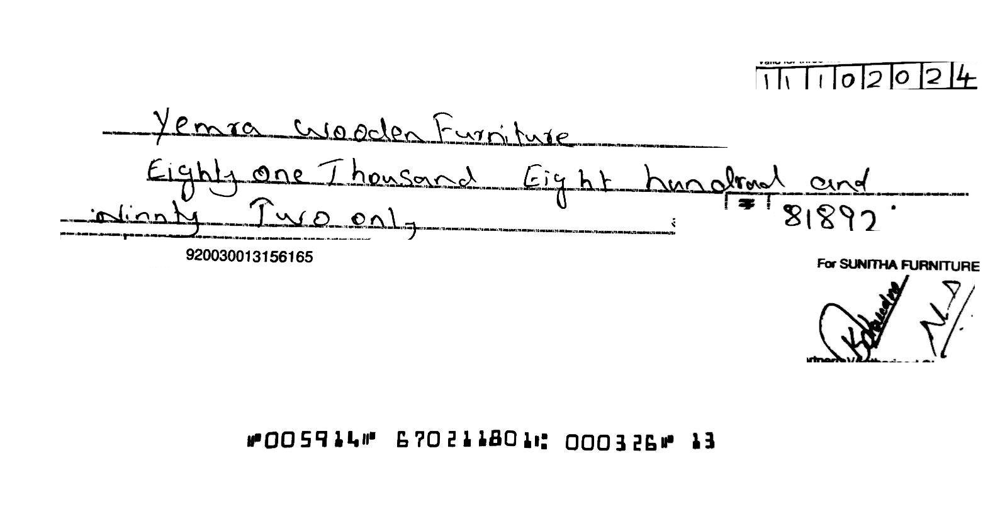

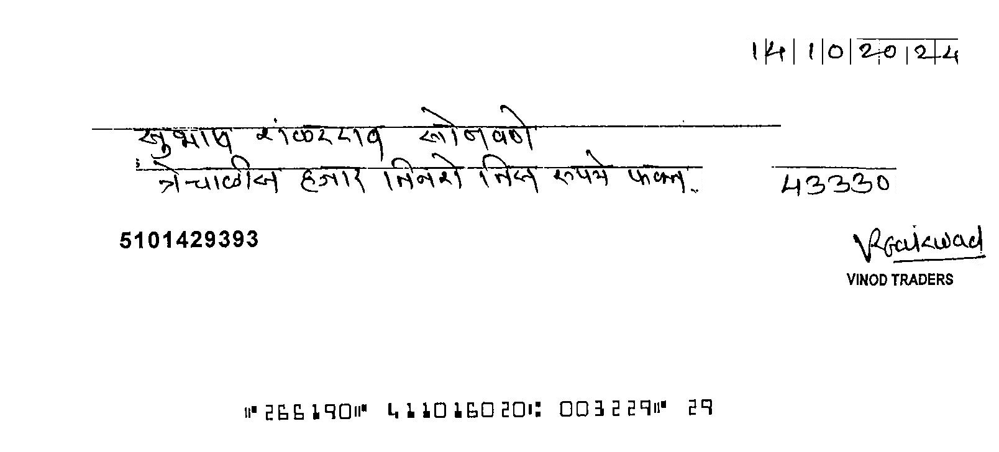

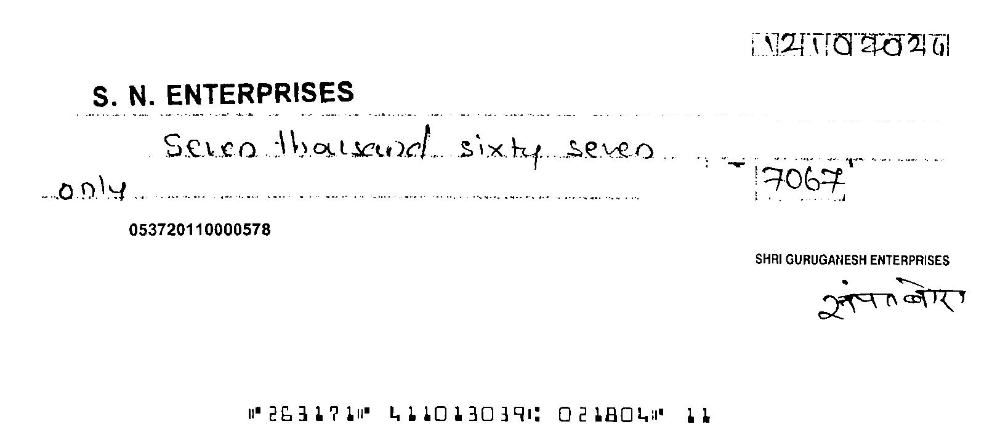

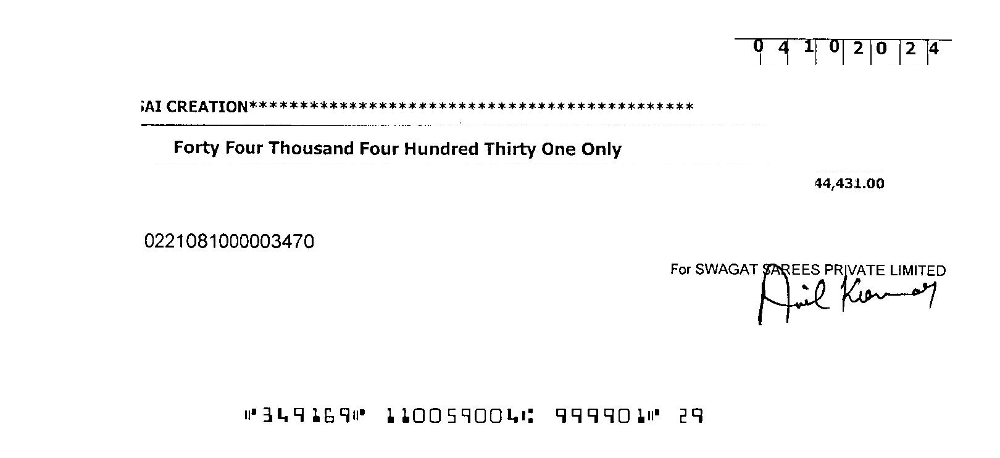

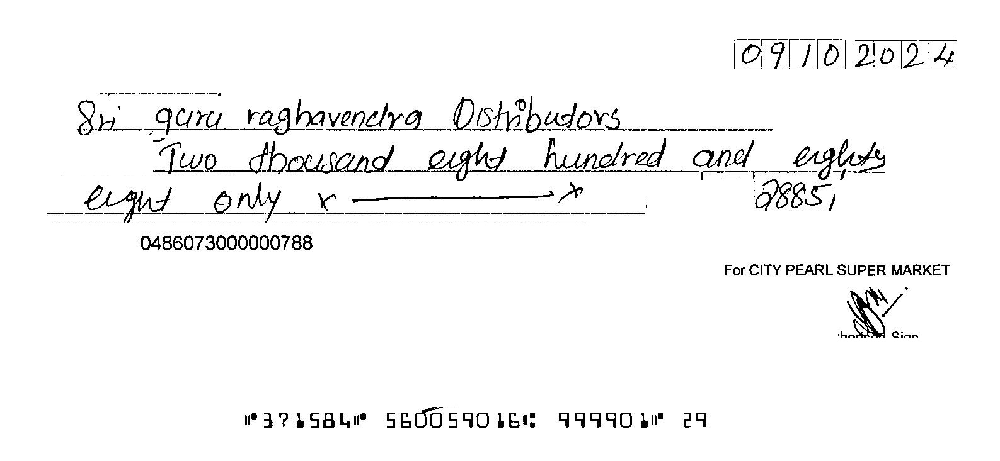

...

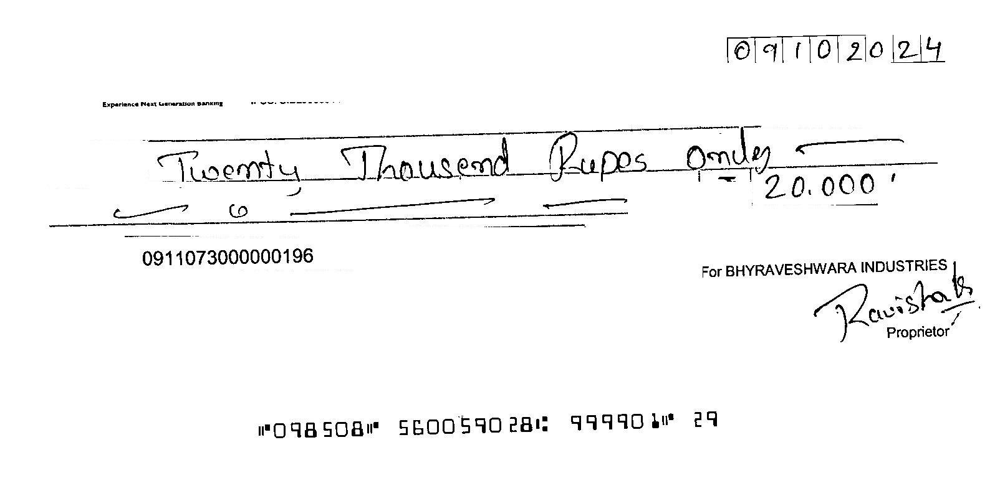

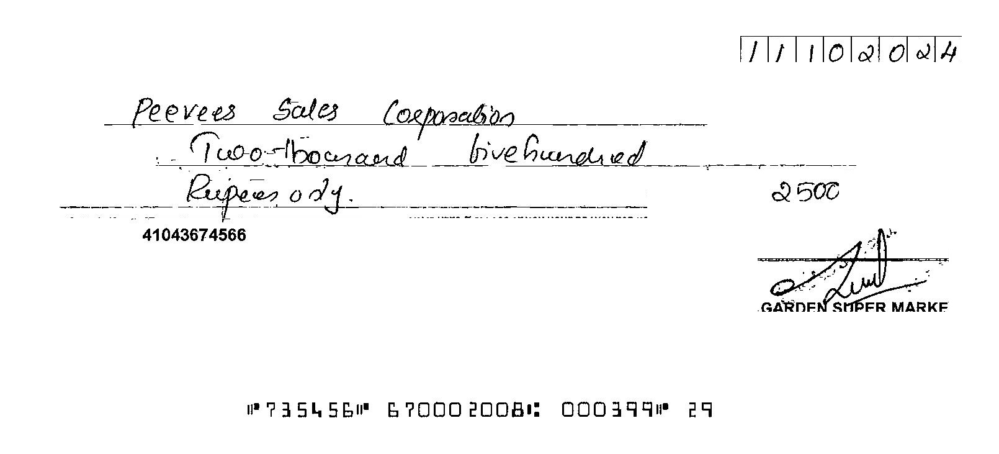

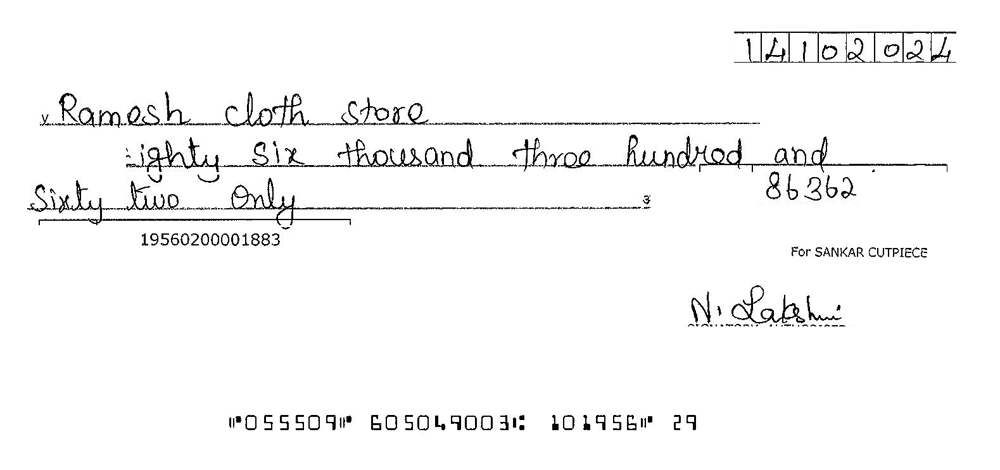

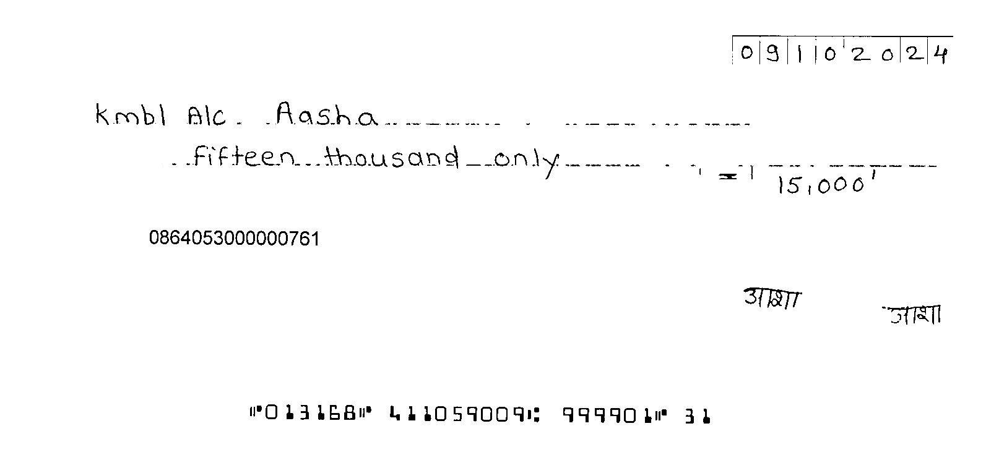

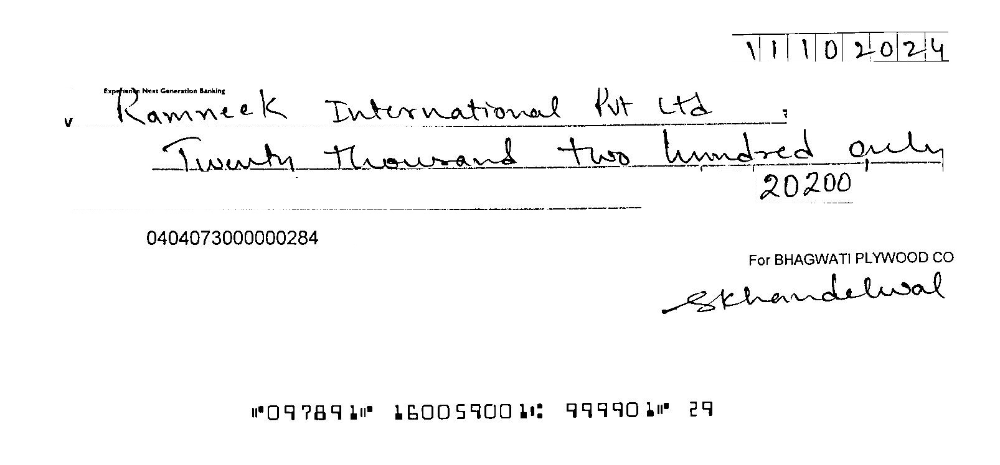

In [47]:
import cv2
import os
from google.colab.patches import cv2_imshow

# Define the directory where your output images are stored
output_dir = '/content/yolov9/data/output_images2'  # Change this if needed

# List all images in the output directory
output_images = [f for f in os.listdir(output_dir) if f.endswith(('.jpg', '.png'))]

# Display each output image
for image_name in output_images:
    image_path = os.path.join(output_dir, image_name)
    output_image = cv2.imread(image_path)

    if output_image is not None:
        cv2_imshow(output_image)
        cv2.waitKey(0)  # Wait for a key press to show the next image
    else:
        print(f"Error loading image {image_path}")


In [49]:
folder_path = '/content/yolov9/data/output_images1'  # Replace with the actual path to your folder

shutil.rmtree(folder_path)

Now to start with just the content


In [53]:
# Load the JSON data from detections.json
with open('/content/yolov9/runs/detect/exp/detections.json', 'r') as f:
    detections = json.load(f)

# Define the directory where your images are stored
image_dir = '/content/yolov9/data/test/images'  # Change this to your actual image directory
output_dir2 = '/content/yolov9/data/output_images3'  # Directory to save the output images
os.makedirs(output_dir2, exist_ok=True)

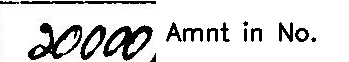

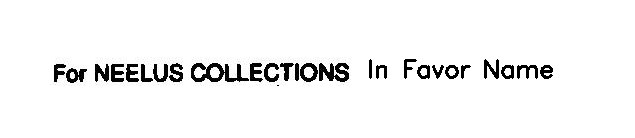

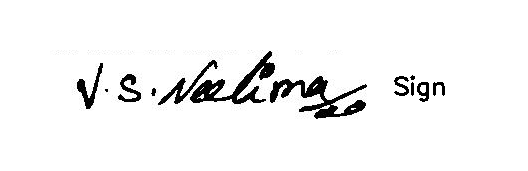

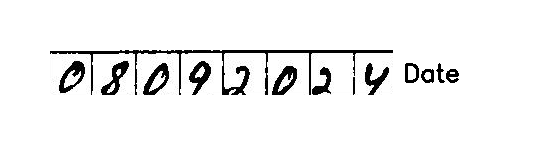

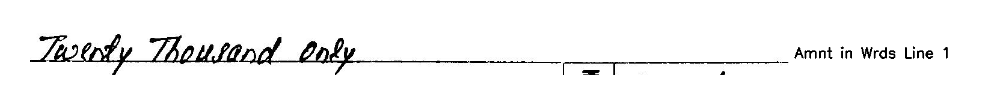

...

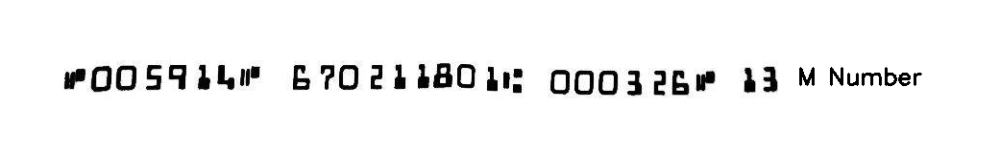

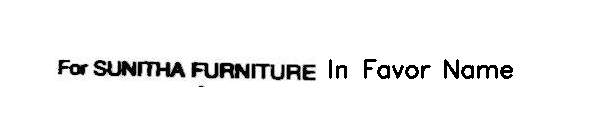

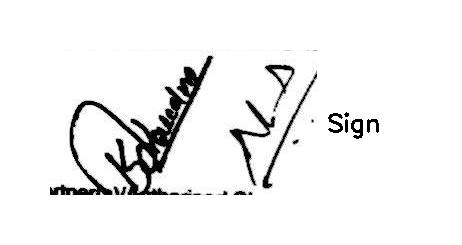

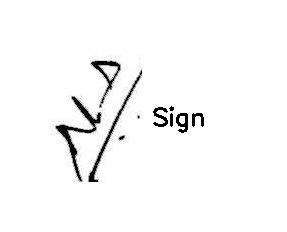

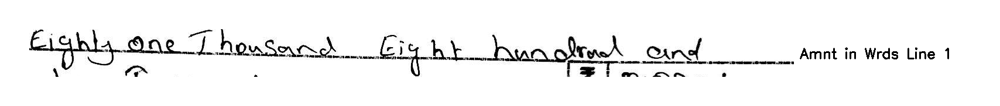

In [57]:
# Define class names
class_names = ["Accnt Number", "Amnt in No.", "Amnt in Wrds Line 1", "Amnt in Wrds Line 2", "Date", "In Favor Name", "M Number", "Name", "Sign"]

# Set the margin to add space between detections
margin = 50  # Space between each cheque bounding box

# Iterate through detections and create images
for idx, detection in enumerate(detections):
    image_name = detection['image']
    x1, y1, x2, y2 = int(detection['x1']), int(detection['y1']), int(detection['x2']), int(detection['y2'])

    # Load the image
    image_path = os.path.join(image_dir, image_name)
    img = cv2.imread(image_path)

    if img is None:
        print(f"Image {image_name} not found in the directory.")
        continue

    # Crop the detected area from the original image
    cropped_img = img[y1:y2, x1:x2]

    # Get the class name
    class_id = int(detection['class'])
    class_name = class_names[class_id] if class_id < len(class_names) else "Unknown"

    # Estimate the required width for the class name
    (text_width, text_height), _ = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, 0.8, 2)
    padding = 20  # Extra padding space around the text
    box_img_width = cropped_img.shape[1] + text_width + padding + 20
    box_img_height = max(cropped_img.shape[0], text_height + padding)

    # Create a white background image with added margin for separation
    box_img = np.ones((box_img_height, box_img_width, 3), dtype=np.uint8) * 255

    # Place the cropped content on the white background
    box_img[:cropped_img.shape[0], :cropped_img.shape[1]] = cropped_img

    # Add the class name text beside the cropped content
    text_x = cropped_img.shape[1] + 10  # Start text right next to the cropped box
    text_y = max(cropped_img.shape[0] // 2 + text_height // 2, 25)  # Center text vertically if possible
    cv2.putText(box_img, class_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 0), 2)

    # Apply margin if this is not the first bounding box for spacing between cheque outputs
    if idx > 0:
        box_img = cv2.copyMakeBorder(box_img, margin, margin, margin, margin, cv2.BORDER_CONSTANT, value=(255, 255, 255))

    # Save the image with the cropped content and class name
    output_path = os.path.join(output_dir, f"{Path(image_name).stem}_{class_name}_content_box.png")
    cv2.imwrite(output_path, box_img)

    # Display the image using cv2_imshow
    cv2_imshow(box_img)

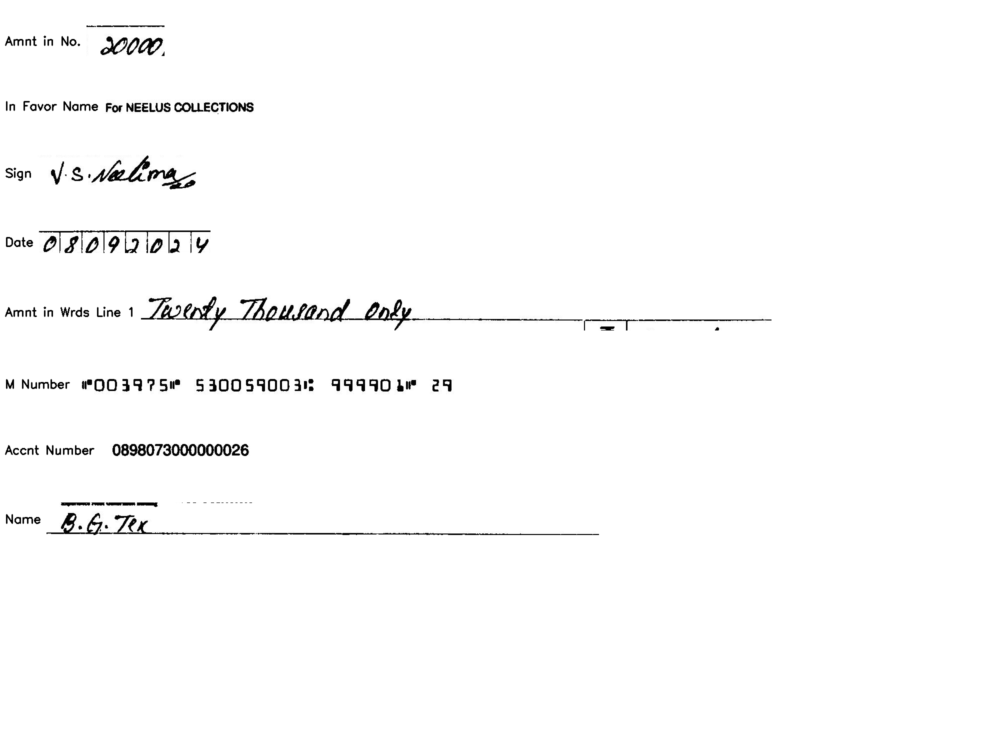

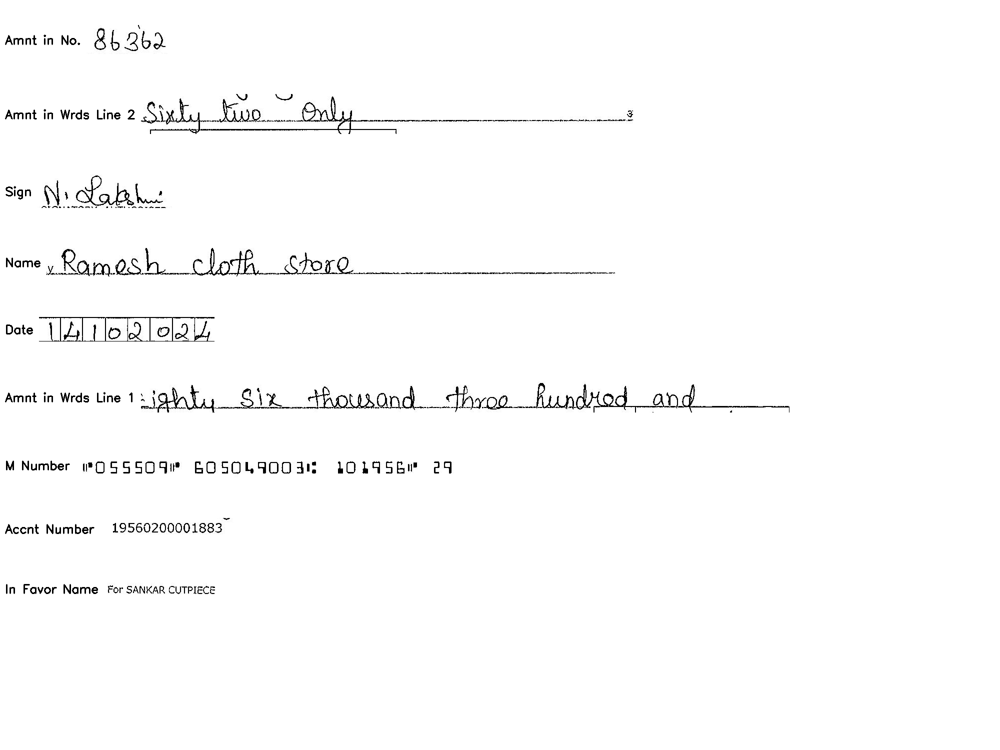

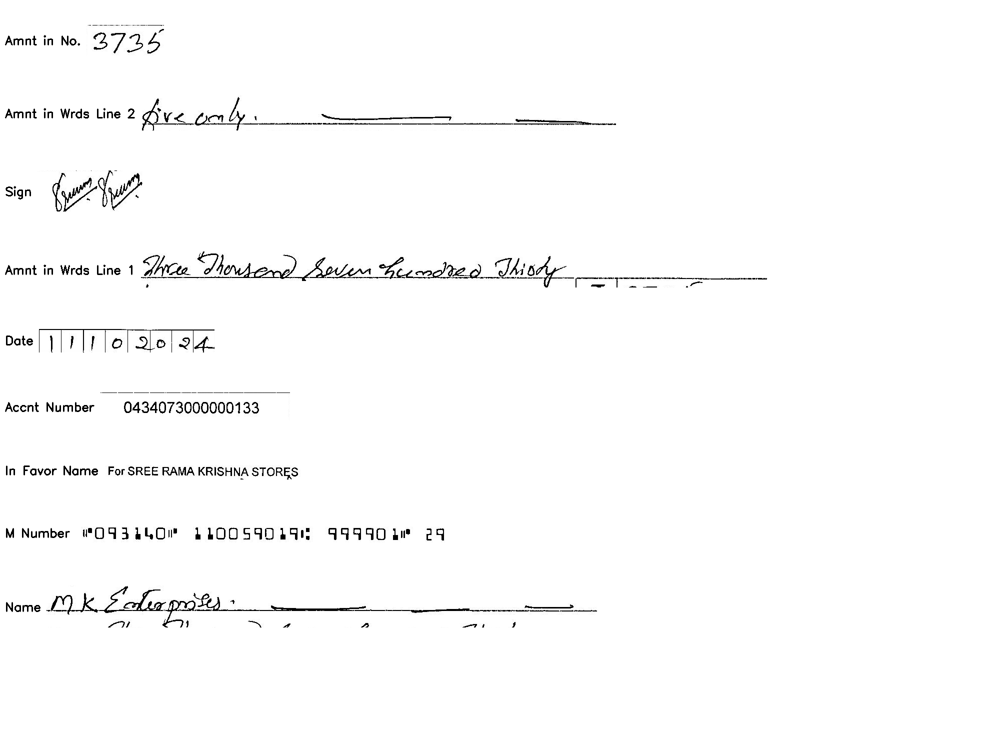

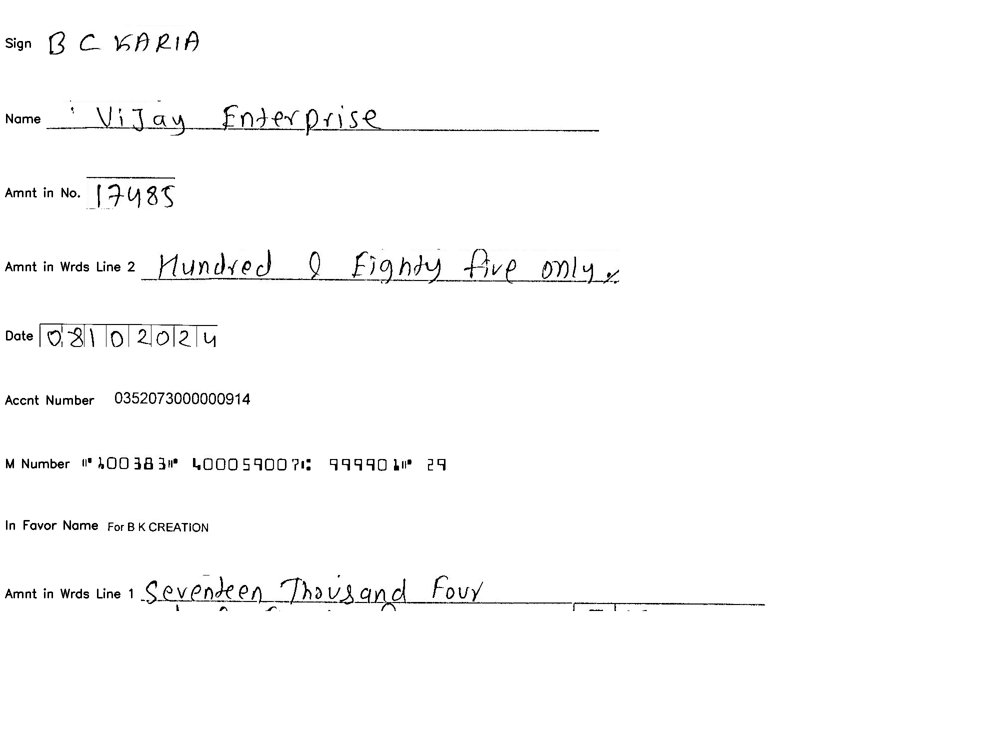

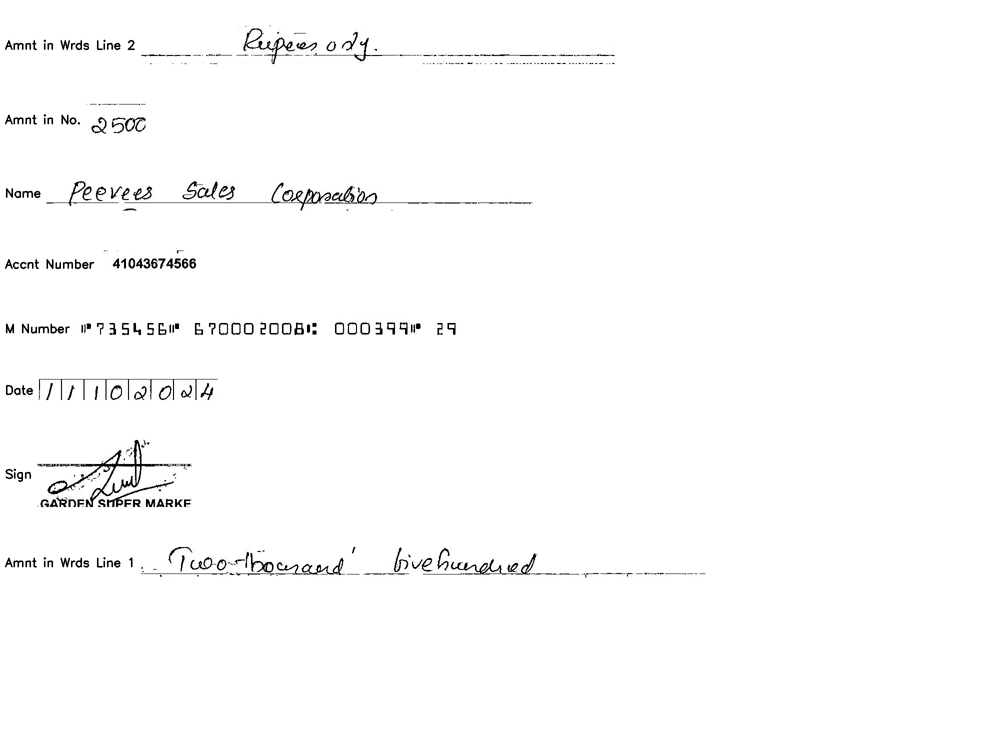

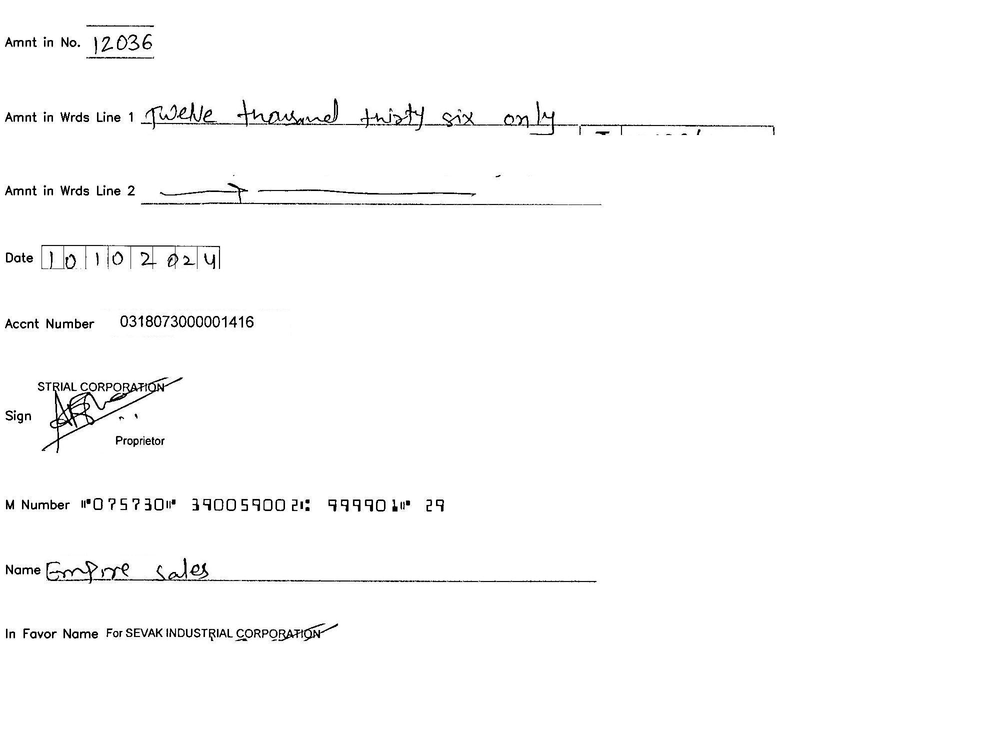

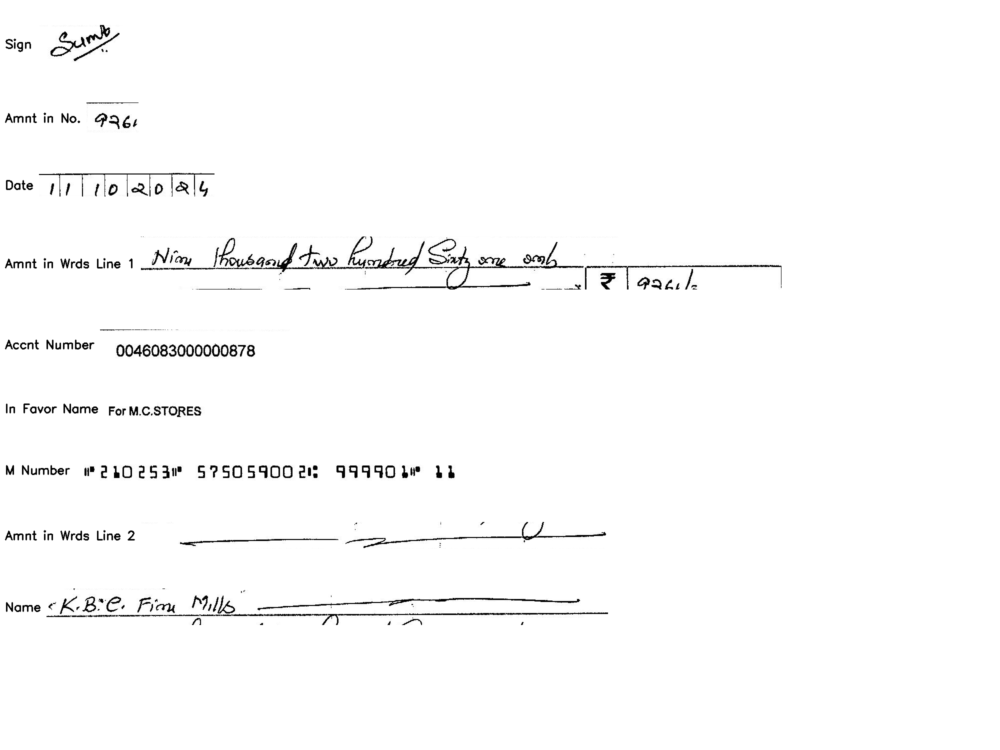

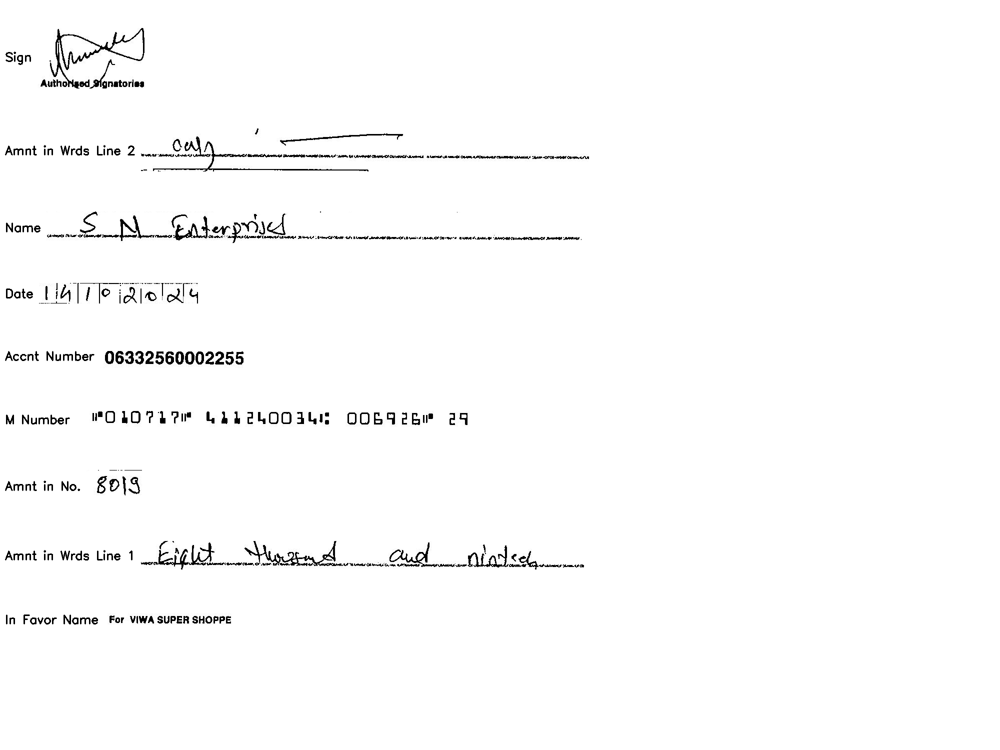

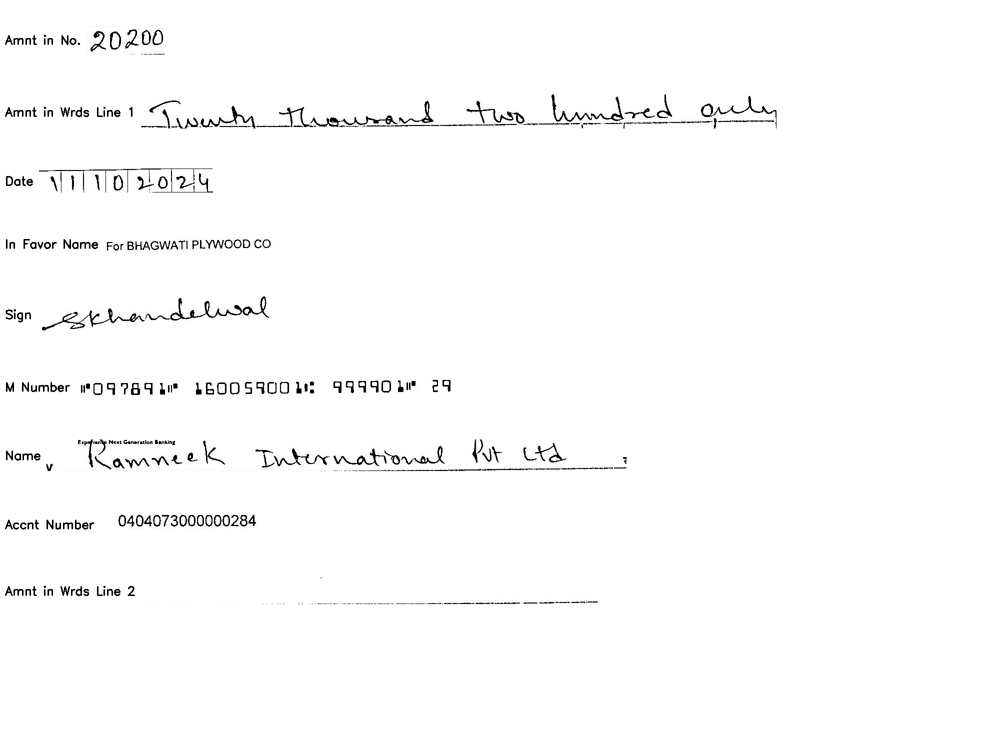

Not enough space to add more boxes for 88506086-20241014134936_TIFFront.jpg. Output may be cropped.


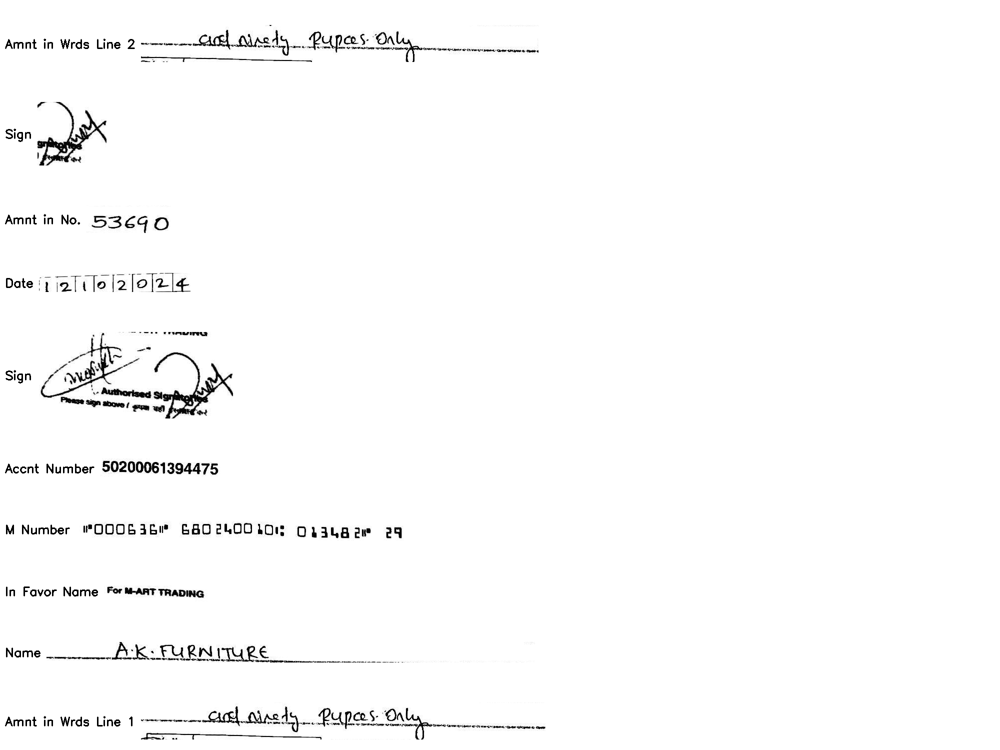

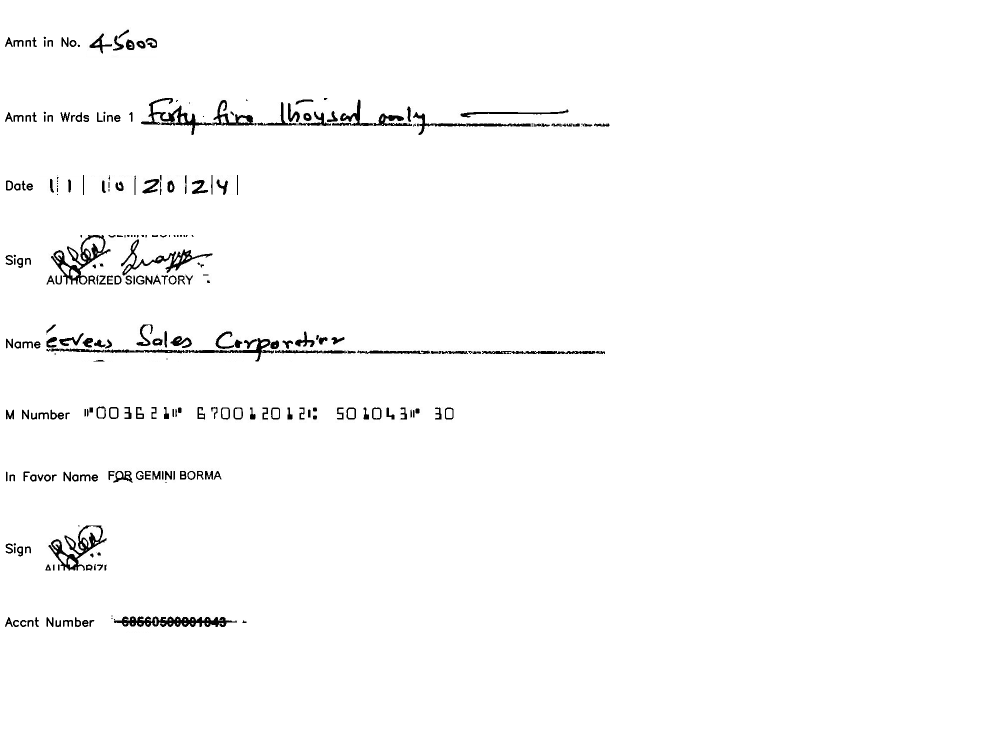

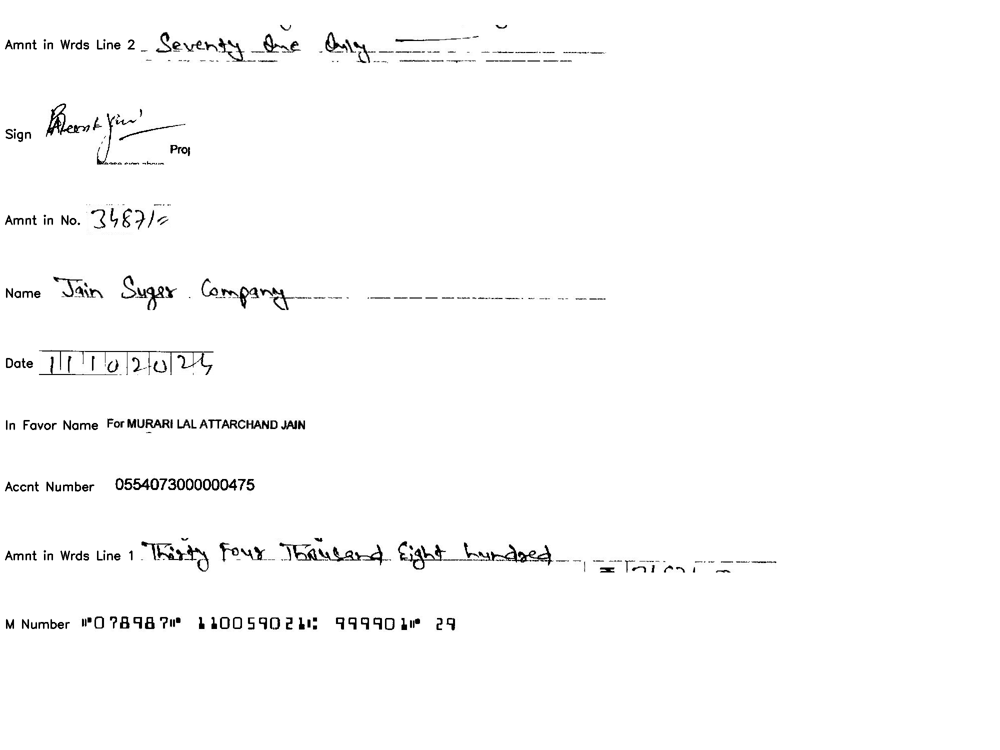

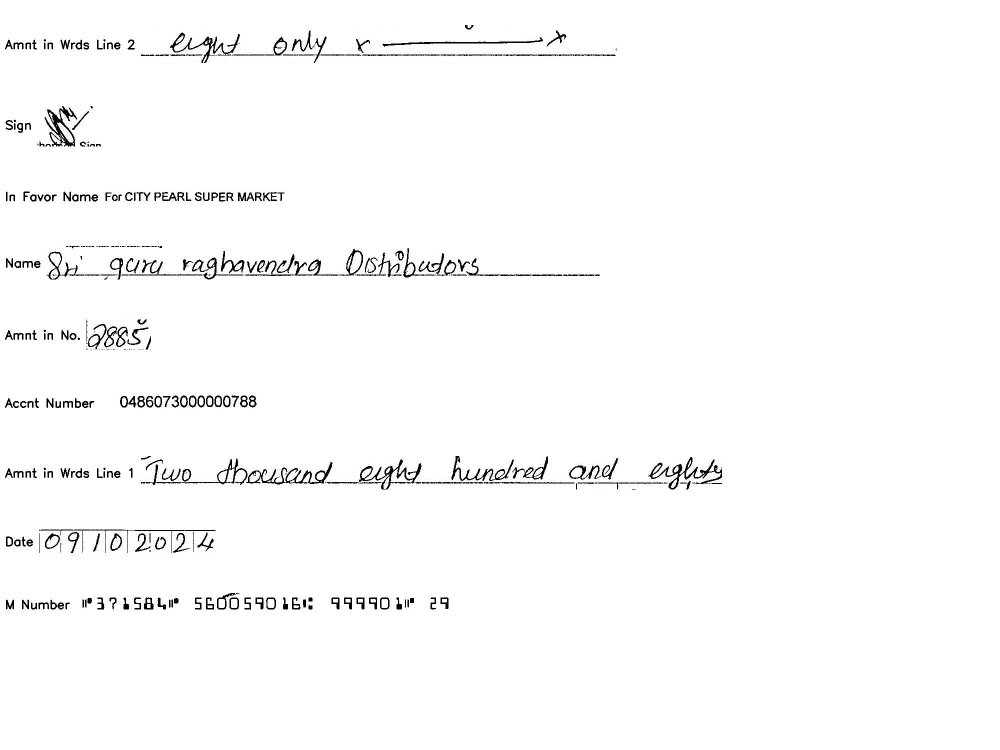

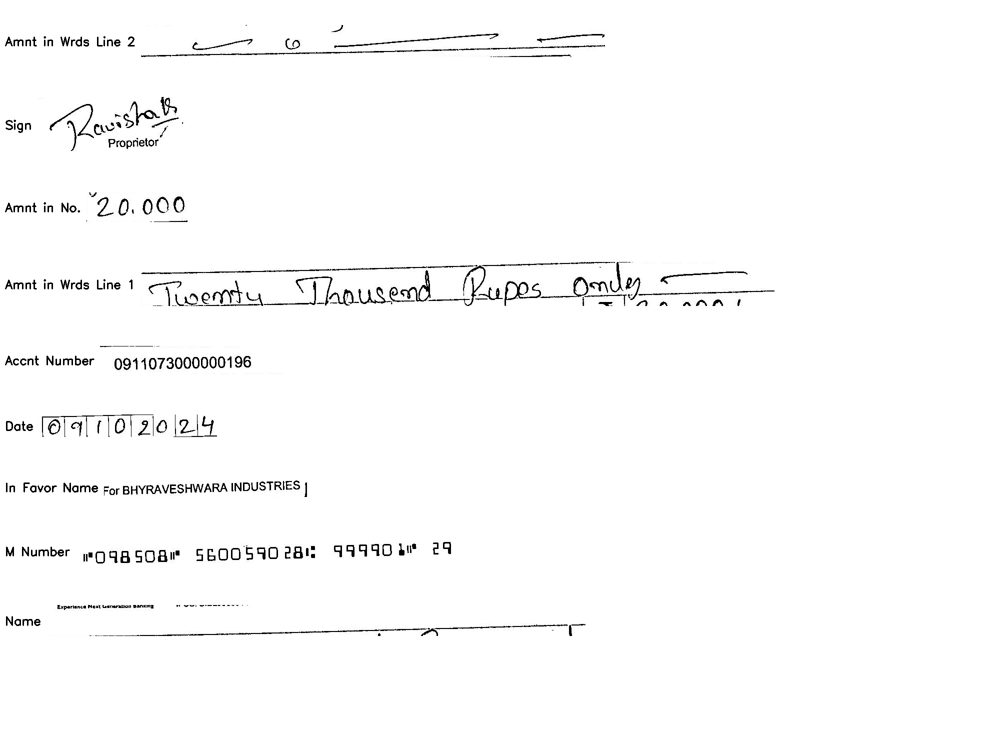

...

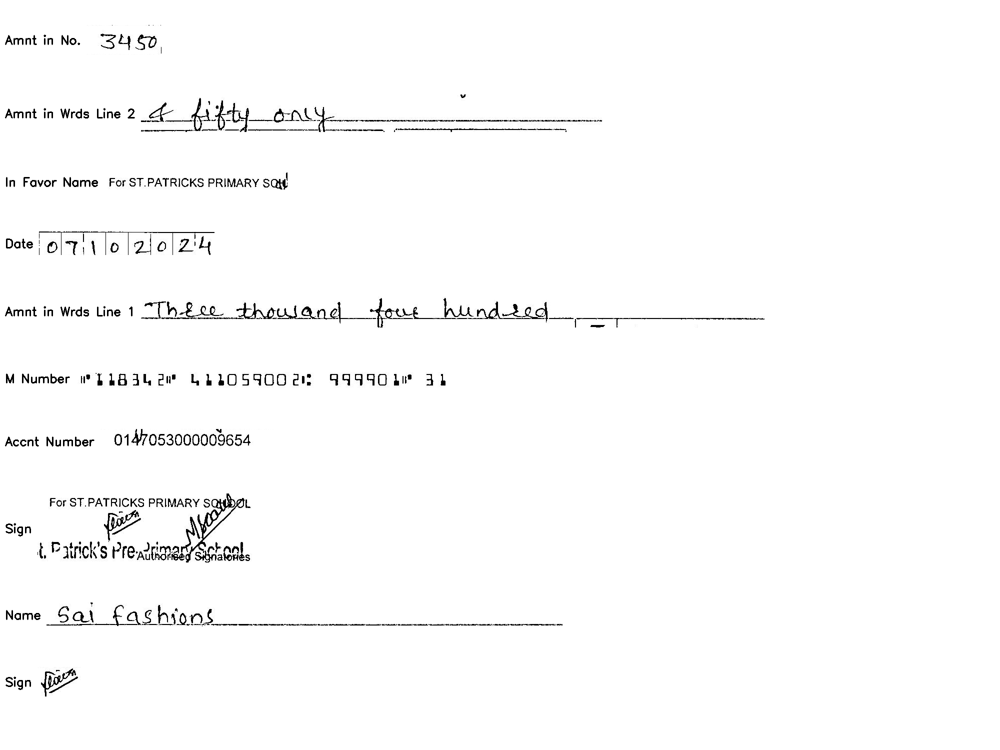

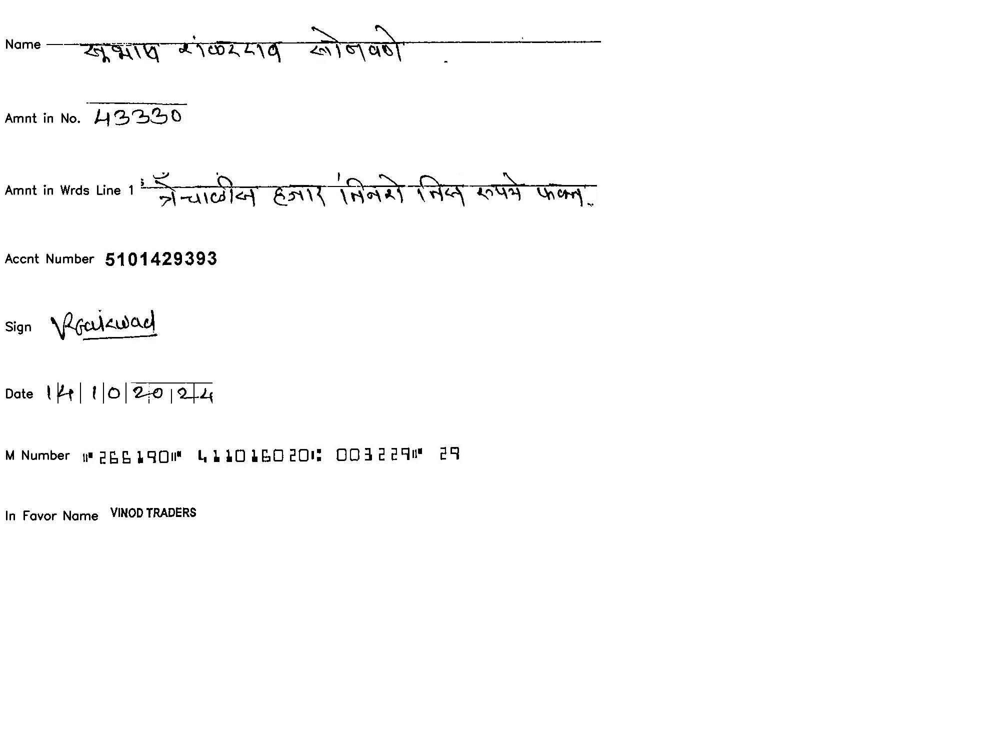

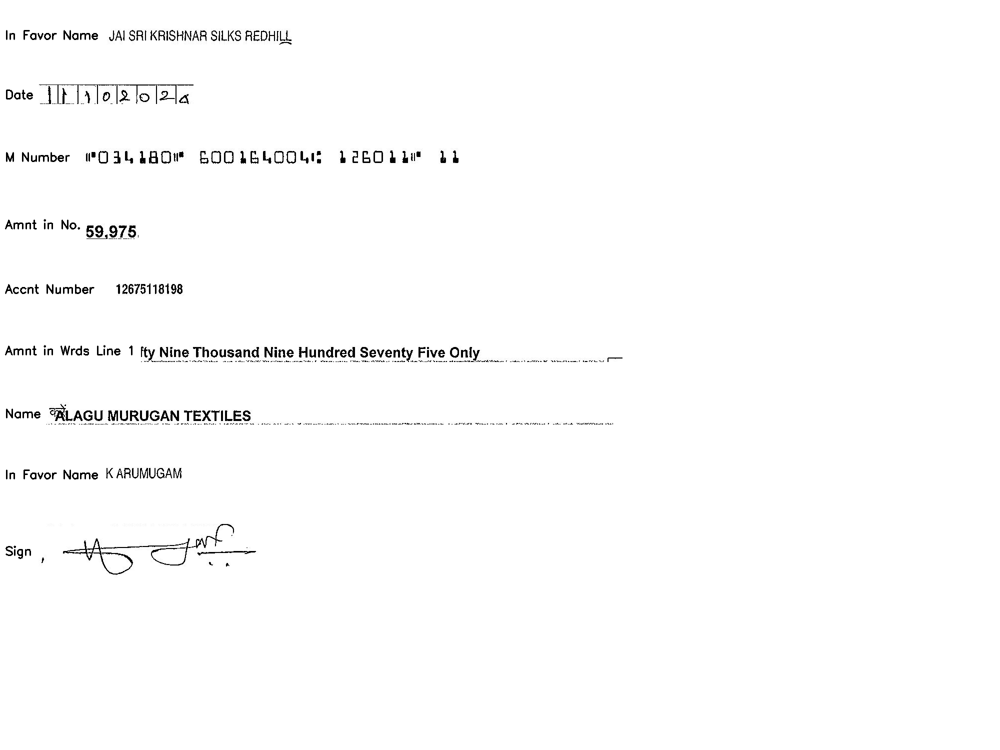

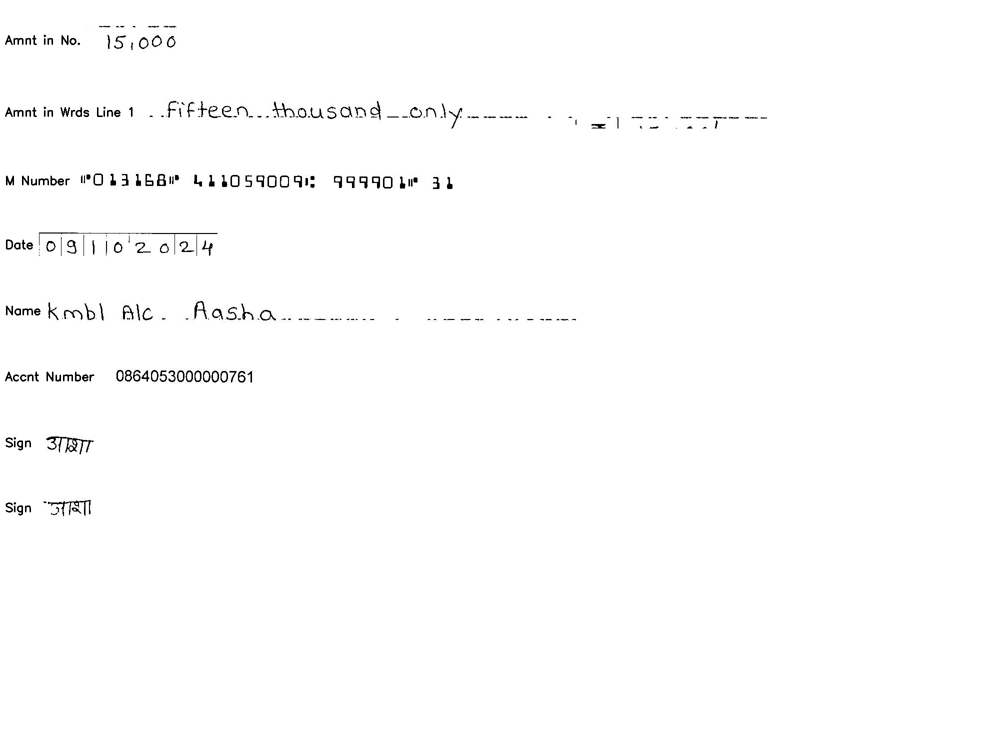

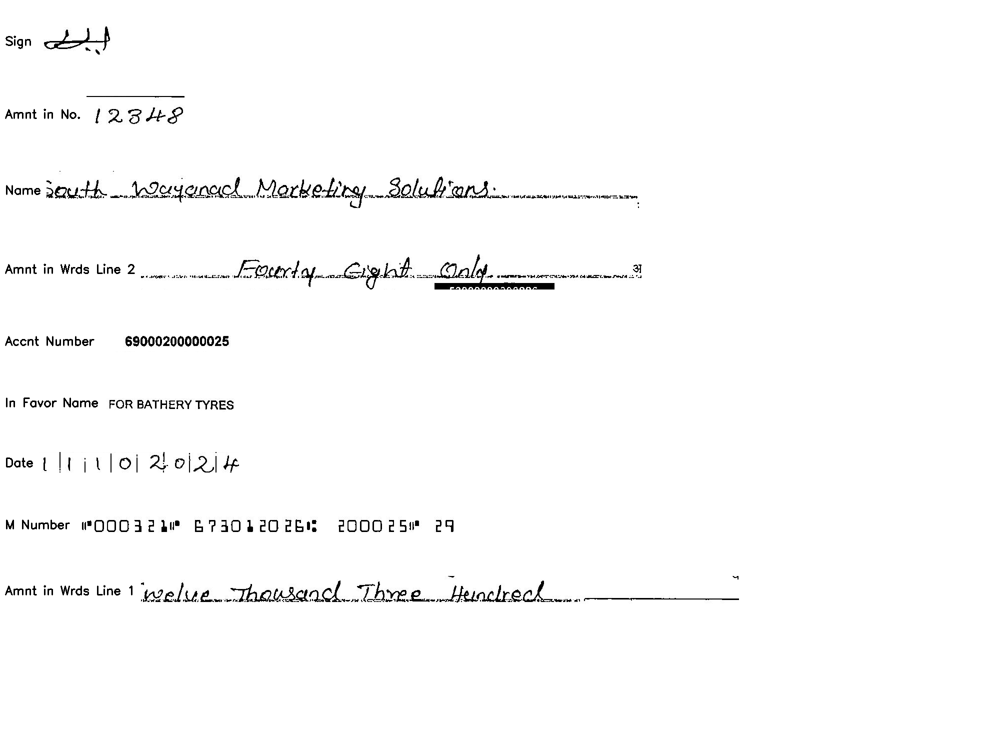

Not enough space to add more boxes for b53a2338-20241014140331_TIFFront.jpg. Output may be cropped.


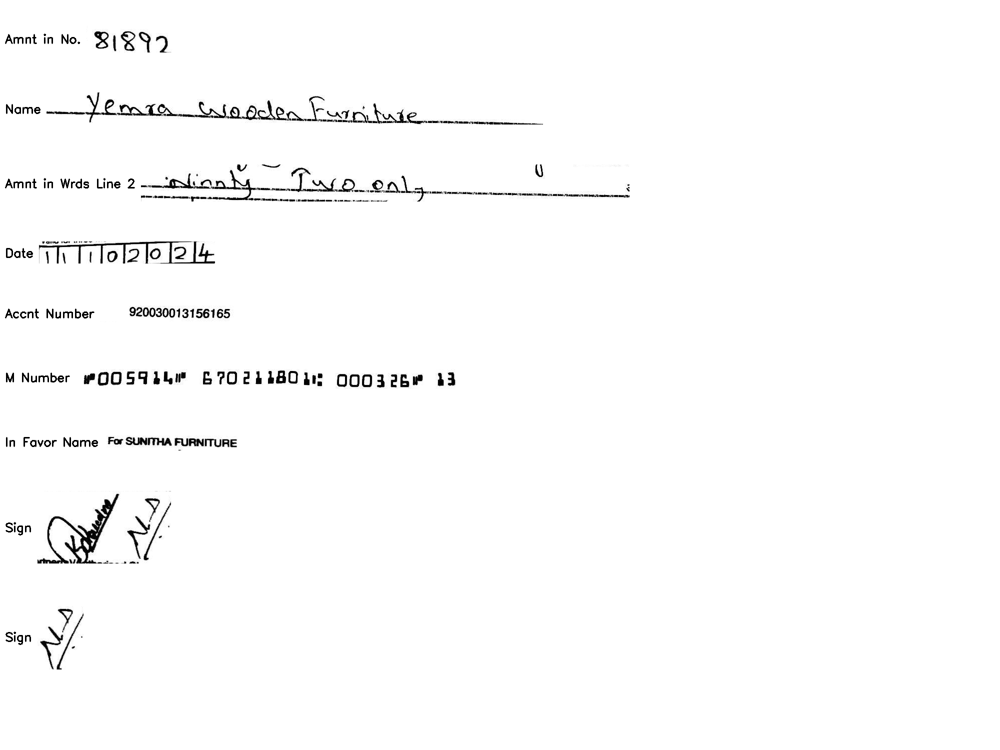

In [65]:
# Define class names
class_names = ["Accnt Number", "Amnt in No.", "Amnt in Wrds Line 1", "Amnt in Wrds Line 2", "Date", "In Favor Name", "M Number", "Name", "Sign"]

# Set the output image size and space between cheque groups
output_width = 2000  # Adjust as needed for larger images
output_height = 1500  # Adjust as needed for larger images
cheque_margin = 100  # Space between separate cheques
box_margin = 80  # Additional space between bounding boxes

# Group detections by image
from collections import defaultdict
detections_by_image = defaultdict(list)
for detection in detections:
    detections_by_image[detection['image']].append(detection)

# Create output for each image
for image_name, boxes in detections_by_image.items():
    # Initialize a white background canvas
    output_img = np.ones((output_height, output_width, 3), dtype=np.uint8) * 255
    y_offset = 50  # Initial vertical offset

    # Load the image
    image_path = os.path.join(image_dir, image_name)
    img = cv2.imread(image_path)
    if img is None:
        print(f"Image {image_name} not found in the directory.")
        continue

    # Process each bounding box
    for detection in boxes:
        x1, y1, x2, y2 = int(detection['x1']), int(detection['y1']), int(detection['x2']), int(detection['y2'])
        class_id = int(detection['class'])
        class_name = class_names[class_id] if class_id < len(class_names) else "Unknown"

        # Crop the detected area from the original image
        cropped_img = img[y1:y2, x1:x2]

        # Calculate width for the class name and cropped image side-by-side
        (text_width, text_height), _ = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, 0.8, 2)
        box_img_width = text_width + 20 + cropped_img.shape[1]
        box_img_height = max(cropped_img.shape[0], text_height + 20)

        # Create a white background image for the class name and cropped content
        box_img = np.ones((box_img_height, box_img_width, 3), dtype=np.uint8) * 255

        # Add the class name text on the left
        text_x, text_y = 10, box_img_height // 2 + text_height // 2
        cv2.putText(box_img, class_name, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 0), 2)

        # Place the cropped content next to the class name
        box_img[0:cropped_img.shape[0], text_width + 20:text_width + 20 + cropped_img.shape[1]] = cropped_img

        # Check if there is enough space in output_img for the new box_img
        if y_offset + box_img.shape[0] <= output_height:
            # Place this box in the output image
            output_img[y_offset:y_offset + box_img.shape[0], :box_img.shape[1]] = box_img
            y_offset += box_img.shape[0] + box_margin  # Move y_offset for the next bounding box
        else:
            print(f"Not enough space to add more boxes for {image_name}. Output may be cropped.")
            break  # Exit the loop if there's not enough space

    # Move y_offset down to add a margin between cheques
    y_offset += cheque_margin

    # Save the output image for the cheque
    output_path = os.path.join(output_dir, f"{Path(image_name).stem}_output_cheque.png")
    cv2.imwrite(output_path, output_img)

    # Display the image using cv2_imshow
    cv2_imshow(output_img)
